# Example Notebook (Adult Census Income Dataset)

In [1]:
import os
import xai
import logging as log 
import warnings
import matplotlib.pyplot as plt
import sys, os
from util.commons import *
from util.ui import *
from util.model import *
from util.split import *
from util.dataset import *
from IPython.display import display, HTML

/home/g3no/github/XAI-Analytics/venv/lib/python3.8/site-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.metrics.scorer module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)
/home/g3no/github/XAI-Analytics/venv/lib/python3.8/site-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.feature_selection.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.feature_selection. Anything that cannot be imported from sklearn.feature_selection is now part of the private API.
  warnings.warn(message, FutureWarning)


## Load a dataset
For this example we are going to use 'Adult Census Dataset'. It consists of both categorical and numerical features.

In [2]:
dataset, msg = get_dataset('census')
display(msg)
display(dataset.df)

"Dataset 'census (Adult census dataset)' loaded successfully. For further information about this dataset please visit: https://ethicalml.github.io/xai/index.html?highlight=load_census#xai.data.load_census"

,age,workclass,education,education-num,marital-status,occupation,relationship,ethnicity,gender,capital-gain,capital-loss,hours-per-week,loan
0,39,State-gov,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,<=50K
1,50,Self-emp-not-inc,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,<=50K
2,38,Private,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,<=50K
3,53,Private,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,<=50K
4,28,Private,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27,Private,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,<=50K
32557,40,Private,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,>50K
32558,58,Private,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,<=50K
32559,22,Private,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,<=50K


## Preprocess the dataset
There are values in the dataset that are unknown (*\?*). In this step all rows containing such values are going to be removed. 

In [3]:
dataset.df['workclass'].unique()

array([' State-gov', ' Self-emp-not-inc', ' Private', ' Federal-gov',
       ' Local-gov', ' ?', ' Self-emp-inc', ' Without-pay',
       ' Never-worked'], dtype=object)

In [4]:
dataset.df.loc[dataset.df['workclass'] == ' ?']

,age,workclass,education,education-num,marital-status,occupation,relationship,ethnicity,gender,capital-gain,capital-loss,hours-per-week,loan
27,54,?,Some-college,10,Married-civ-spouse,?,Husband,Asian-Pac-Islander,Male,0,0,60,>50K
61,32,?,7th-8th,4,Married-spouse-absent,?,Not-in-family,White,Male,0,0,40,<=50K
69,25,?,Some-college,10,Never-married,?,Own-child,White,Male,0,0,40,<=50K
77,67,?,10th,6,Married-civ-spouse,?,Husband,White,Male,0,0,2,<=50K
106,17,?,10th,6,Never-married,?,Own-child,White,Female,34095,0,32,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...
32530,35,?,Bachelors,13,Married-civ-spouse,?,Wife,White,Female,0,0,55,>50K
32531,30,?,Bachelors,13,Never-married,?,Not-in-family,Asian-Pac-Islander,Female,0,0,99,<=50K
32539,71,?,Doctorate,16,Married-civ-spouse,?,Husband,White,Male,0,0,10,>50K
32541,41,?,HS-grad,9,Separated,?,Not-in-family,Black,Female,0,0,32,<=50K


In [5]:
dataset.df = remove_undefined_rows(' ?', dataset.df)
dataset.df['workclass'].unique()

array([' State-gov', ' Self-emp-not-inc', ' Private', ' Federal-gov',
       ' Local-gov', ' Self-emp-inc', ' Without-pay'], dtype=object)

## Visualize the dataset
Three visualization functions offered by the [XAI](https://github.com/EthicalML/XAI) module will be used for analyzing the dataset.
* The first one shows the imbalances of selected features. In the first plot below, for example, we can see that the majority of samples (people) are *white* *male* (gender='Male', ethnicity='White').
* The second and third plots show correlations between the features. The second one plots the correlations as a matrix, whereas the third one as a hierarchical dendogram.

19-Nov-20 15:45:07 - No categorical_cols passed so inferred using np.object, np.int8 and np.bool: Index(['workclass', 'education', 'marital-status', 'occupation',
       'relationship', 'ethnicity', 'gender', 'loan'],
      dtype='object'). If you see an error these are not correct, please provide them as a string array as: categorical_cols=['col1', 'col2', ...]


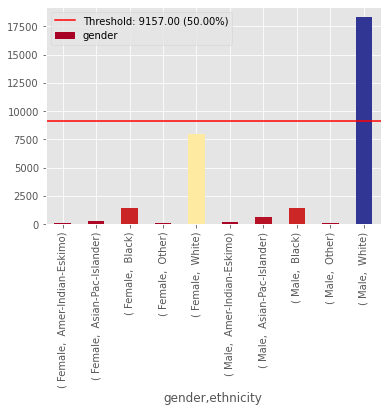

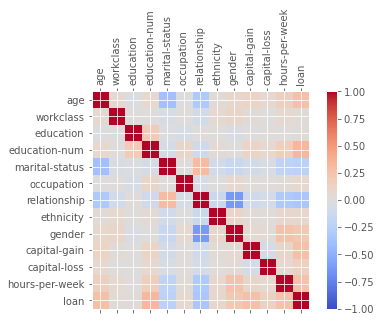

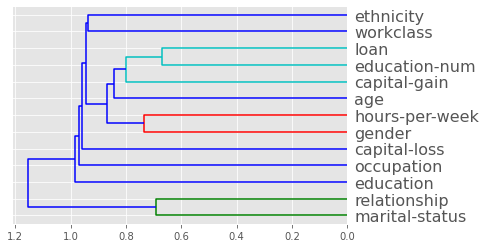

array([[ 1.00000000e+00,  6.86335792e-02, -1.60837620e-02,
         7.08272459e-02, -3.76311933e-01, -6.86514106e-03,
        -3.04712402e-01,  2.41909155e-02,  9.19024416e-02,
         1.22225101e-01,  6.14962762e-02,  1.55807704e-01,
         2.77229605e-01],
       [ 6.86335792e-02,  1.00000000e+00,  5.92116049e-03,
         7.37335824e-03, -3.95700067e-02,  1.13933632e-02,
        -9.26449540e-02,  6.28109671e-02,  9.58413386e-02,
         2.69173566e-02,  5.61899528e-03,  6.65712342e-02,
         3.00769141e-02],
       [-1.60837620e-02,  5.92116049e-03,  1.00000000e+00,
         1.90662013e-01, -1.87240235e-02, -4.33184577e-02,
         1.30577721e-02,  7.59238028e-03, -3.36840093e-02,
         6.76440411e-03,  6.55604932e-03,  1.22378817e-02,
         2.95752491e-02],
       [ 7.08272459e-02,  7.37335824e-03,  1.90662013e-01,
         1.00000000e+00, -5.93347575e-02,  9.87161697e-02,
        -9.47528068e-02,  4.30169362e-02,  2.01137543e-03,
         1.22221879e-01,  7.50899805e

In [6]:
%matplotlib inline
plt.style.use('ggplot')
warnings.filterwarnings('ignore')

imbalanced_cols = ['gender', 'ethnicity']

xai.imbalance_plot(dataset.df, *imbalanced_cols)
xai.correlations(dataset.df, include_categorical=True, plot_type="matrix")
xai.correlations(dataset.df, include_categorical=True)

## Target
In the cell below the target variable is selected. In this example we will use the column **loan** as target variable, which shows whether a person earns more than 50k (*>50K | <=50K*) per year.

In [7]:
df_X, df_y, msg = split_feature_target(dataset.df, "loan")
df_y

19-Nov-20 15:45:10 - Target 'loan' selected successfully.


0         <=50K
1         <=50K
2         <=50K
3         <=50K
4         <=50K
          ...  
32556     <=50K
32557      >50K
32558     <=50K
32559     <=50K
32560      >50K
Name: loan, Length: 30718, dtype: object

## Training the models
In this step three models are going to be trained on this dataset. In the output below we can see classification reports for the trained models.
 * Model 1: Logistic Regression
 * Model 2: Random Forest
 * Model 3: Decision Tree

In [8]:
# Create three empty models
initial_models, msg = fill_empty_models(df_X, df_y, 3)
models = []

# Train model 1
model1 = initial_models[0]
msg = fill_model(model1, Algorithm.LOGISTIC_REGRESSION, Split(SplitTypes.IMBALANCED, None))
models.append(model1)

# Train model 2
model2 = initial_models[1]
msg = fill_model(model2, Algorithm.RANDOM_FOREST, Split(SplitTypes.IMBALANCED, None))
models.append(model2)

# Train model 3
model3 = initial_models[2]
msg = fill_model(model3, Algorithm.DECISION_TREE, Split(SplitTypes.IMBALANCED, None))
models.append(model3)

19-Nov-20 15:45:11 - Model accuracy: 0.8029513888888888
19-Nov-20 15:45:13 - Classification report: 
              precision    recall  f1-score   support

       <=50K       0.93      0.79      0.86      6921
        >50K       0.57      0.83      0.68      2295

    accuracy                           0.80      9216
   macro avg       0.75      0.81      0.77      9216
weighted avg       0.84      0.80      0.81      9216

19-Nov-20 15:45:13 - Model Model 1 trained successfully!
19-Nov-20 15:45:27 - Model accuracy: 0.8372395833333334
19-Nov-20 15:45:28 - Classification report: 
              precision    recall  f1-score   support

       <=50K       0.88      0.91      0.89      6921
        >50K       0.69      0.63      0.66      2295

    accuracy                           0.84      9216
   macro avg       0.79      0.77      0.78      9216
weighted avg       0.83      0.84      0.83      9216

19-Nov-20 15:45:29 - Model Model 2 trained successfully!
19-Nov-20 15:45:31 - Model acc

In [9]:
model_1 = models[0]
model_2 = models[1]
model_3 = models[2]

## Global model interpretations
In the following steps we will use global interpretation techniques that help us to answer questions like how does a model behave in general? What features drive predictions and what features are completely useless. This data may be very important in understanding the model better. Most of the techniques work by investigating the conditional interactions between the target variable and the features on the complete dataset.

### Feature importance
The importance of a feature is the increase in the prediction error of the model after we permuted the feature’s values, which breaks the relationship between the feature and the true outcome. A feature is “important” if permuting it increases the model error. This is because in that case, the model relied heavily on this feature for making right prediction. On the other hand, a feature is “unimportant” if permuting it doesn’t affect the error by much or doesn’t change it at all.

#### ELI5
In the first case, we use [ELI5](https://github.com/TeamHG-Memex/eli5), which does not permute the features but only visualizes the weight of each feature.

 * Model 1 (Logistic Regression)

In [10]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_1)
display(plot)

19-Nov-20 15:45:34 - Generating a feature importance plot using ELI5 for Model 1 ...


 * Model2 (Random Forest)

In [11]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_2)
display(plot)

19-Nov-20 15:45:34 - Generating a feature importance plot using ELI5 for Model 2 ...


Weight,Feature
0.2176 ± 0.0692,age
0.1054 ± 0.0269,hours-per-week
0.1018 ± 0.1999,marital-status_ Married-civ-spouse
0.0797 ± 0.0441,capital-gain
0.0660 ± 0.0622,education-num
0.0459 ± 0.1193,marital-status_ Never-married
0.0459 ± 0.1385,relationship_ Husband
0.0259 ± 0.0118,capital-loss
0.0161 ± 0.0190,occupation_ Exec-managerial
0.0158 ± 0.0168,occupation_ Prof-specialty


 * Model 3 (Decision Tree)

In [12]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_3)
display(plot)

19-Nov-20 15:45:34 - Generating a feature importance plot using ELI5 for Model 3 ...


Weight,Feature
0.2894,marital-status_ Married-civ-spouse
0.1628,age
0.1062,education-num
0.1059,capital-gain
0.0852,hours-per-week
0.0286,capital-loss
0.0134,workclass_ Private
0.0123,occupation_ Exec-managerial
0.0108,occupation_ Sales
0.0097,occupation_ Craft-repair


In [13]:
print(generate_feature_importance_explanation(FeatureImportanceType.ELI5, models, 4))

19-Nov-20 15:45:37 - Generating feature importance explanation for ELI5 ...


Summary:
 The highest feature for Model 1 is marital-status_ Married-civ-spouse with weight ~0.813.
 The 2nd most influential feature for Model 1 is occupation_ Exec-managerial with weight ~0.707.
 The 3rd most important feature for Model 1 is relationship_ Wife with weight ~0.615.
 The 4th highest feature for Model 1 is occupation_ Prof-specialty with weight ~0.513.
 
 The highest feature for Model 2 is age with weight ~0.218.
 The 2nd most influential feature for Model 2 is hours-per-week with weight ~0.105.
 The 3rd most important feature for Model 2 is marital-status_ Married-civ-spouse with weight ~0.102, matching 1st for Model 1.
 The 4th most influential feature for Model 2 is capital-gain with weight ~0.08.
 
 The best feature for Model 3 is marital-status_ Married-civ-spouse with weight ~0.289, alike 1st for Model 1.
 The 2nd most influential feature for Model 3 is age with weight ~0.163, same as 1st for Model 2.
 The 3rd best feature for Model 3 is education-num with weight ~

#### Skater

In this step we use the [Skater](https://github.com/oracle/Skater) module, which permutes the features to generate a feature importance plot.

* Model 1 (Logistic Regression)

19-Nov-20 15:45:40 - Generating a feature importance plot using SKATER for Model 1 ...
19-Nov-20 15:45:40 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2020-11-19 15:46:02,618 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 21 seconds

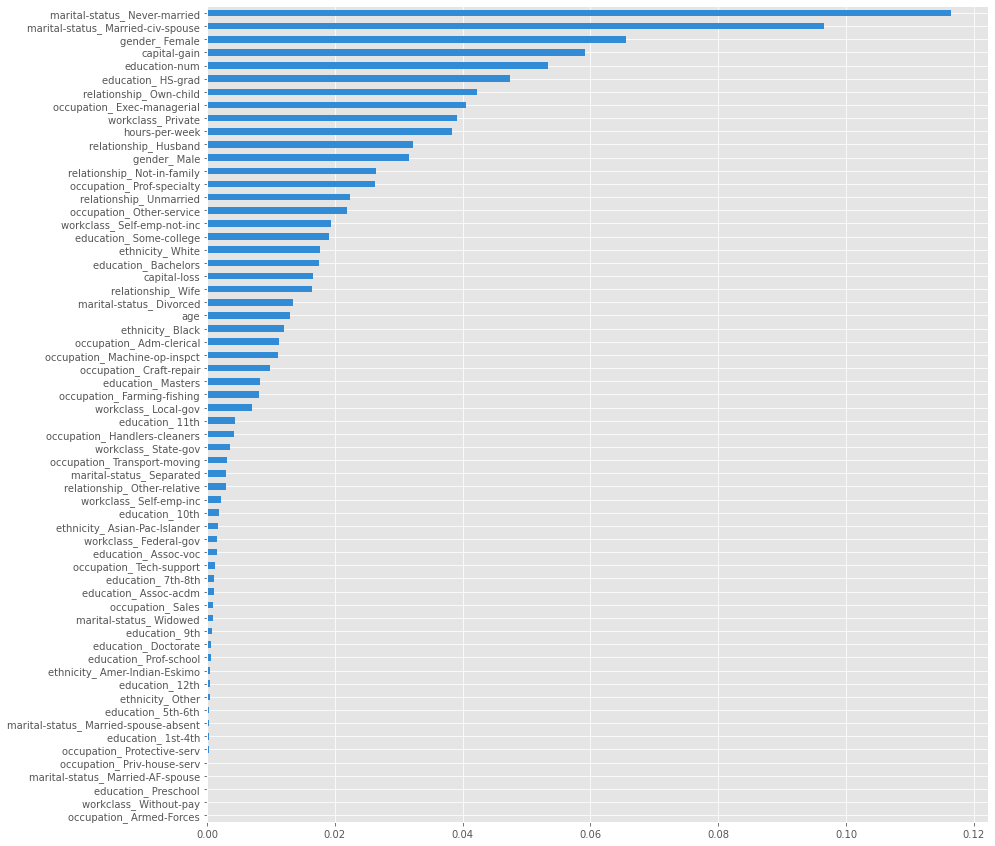

In [14]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [14, 15]
plt.style.use('ggplot')
warnings.filterwarnings('ignore')

_ = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_1)

 * Model2 (Random Forest)

19-Nov-20 15:46:26 - Generating a feature importance plot using SKATER for Model 2 ...
19-Nov-20 15:46:26 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2020-11-19 15:46:48,521 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 33 seconds

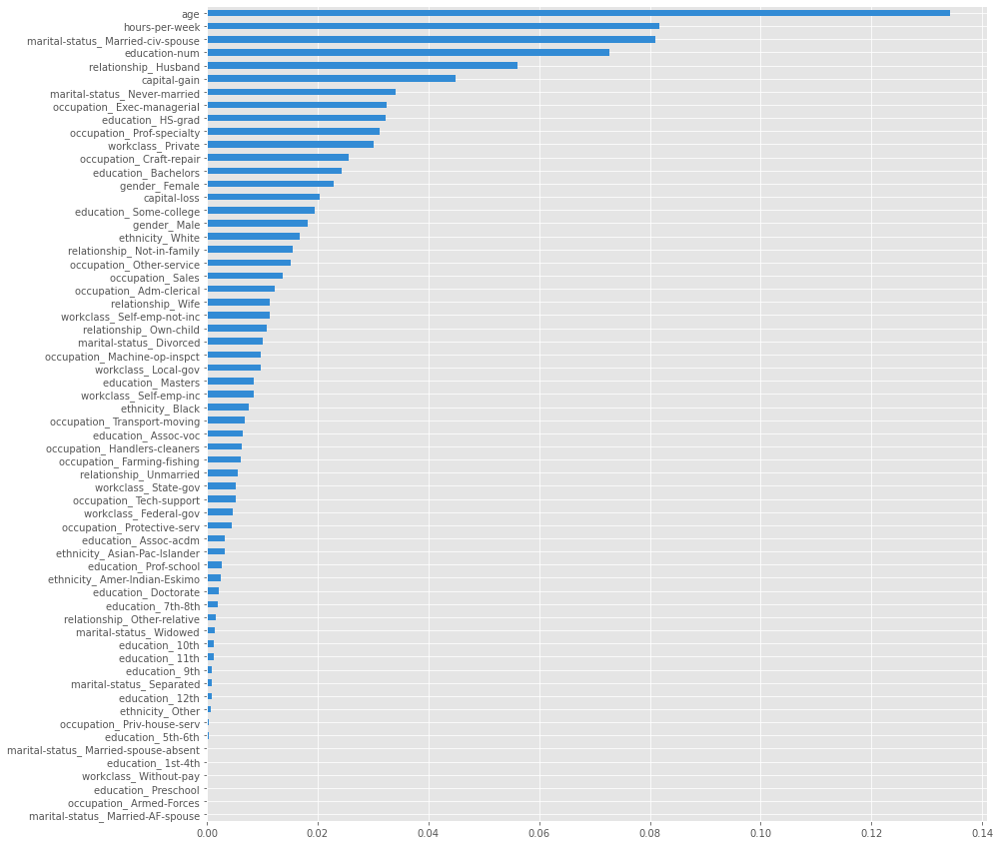

In [15]:
_ = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_2)

 * Model 3 (Decision Tree)

19-Nov-20 15:47:24 - Generating a feature importance plot using SKATER for Model 3 ...
19-Nov-20 15:47:24 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2020-11-19 15:47:45,372 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 19 seconds

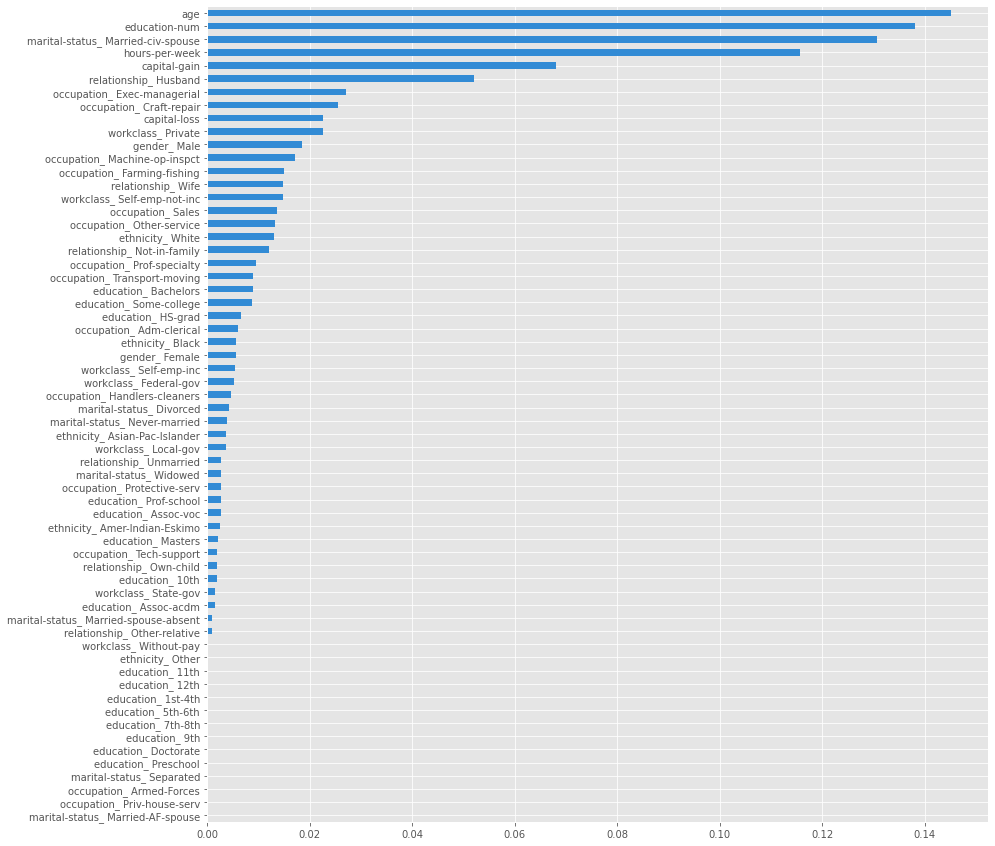

In [16]:
_ = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_3)

In [17]:
print('\n' + generate_feature_importance_explanation(FeatureImportanceType.SKATER, models, 4))

19-Nov-20 15:48:06 - Generating feature importance explanation for SKATER ...
2020-11-19 15:49:55,832 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 44 seconds

2020-11-19 15:52:29,943 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 52 seconds

2020-11-19 15:55:12,849 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 49 seconds
Summary:
 The highest feature for Model 1 is marital-status_ Never-married with weight ~0.107.
 The 2nd most important feature for Model 1 is marital-status_ Married-civ-spouse with weight ~0.096.
 The 3rd most influential feature for Model 1 is capital-gain with weight ~0.069.
 The 4th most valuable feature for Model 1 is gender_ Female with weight ~0.066.
 
 The highest feature for Model 2 is age with weight ~0.127.
 The 2nd best feature for Model 2 is hours-per-week with weight ~0.089.
 The 3rd highest feature for Model 2 is marital-status_ Married-civ-spouse with weight ~0.079, similar to 2nd for Model 1.
 The 4th best feature for Model 2 is education-num with weight ~0.075.
 
 The most important feature for Model 3 is age with weight ~0.157, similar to 1st for Model 2.
 The 2nd most important feature for Model 3 is marital-status_ Married-civ-spouse with weight ~0.149, matching 2nd for Model 1.
 The 3rd best feature fo

#### Shap

In the cell below we use the [SHAP](https://github.com/slundberg/shap) (SHapley Additive exPlanations). It uses a combination of feature contributions and game theory to come up with SHAP values. Then, it computes the global feature importance by taking the average of the SHAP value magnitudes across the dataset.

 * Model 1 (Logistic Regression)

19-Nov-20 15:56:02 - Generating a feature importance plot using SHAP for Model 1 ...
19-Nov-20 15:56:02 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


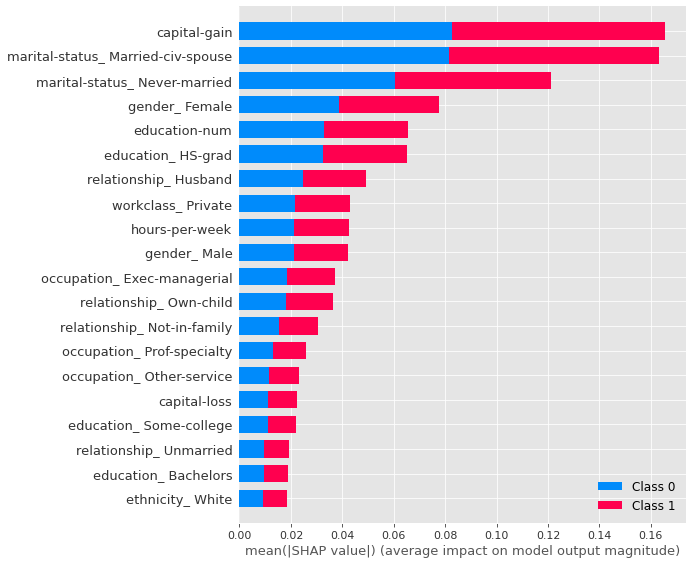

In [18]:
from shap import initjs
initjs()

%matplotlib inline
plt.style.use('ggplot')
warnings.filterwarnings('ignore')

generate_feature_importance_plot(FeatureImportanceType.SHAP, model_1)

 * Model2 (Random Forest)

19-Nov-20 16:08:25 - Generating a feature importance plot using SHAP for Model 2 ...
19-Nov-20 16:08:25 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


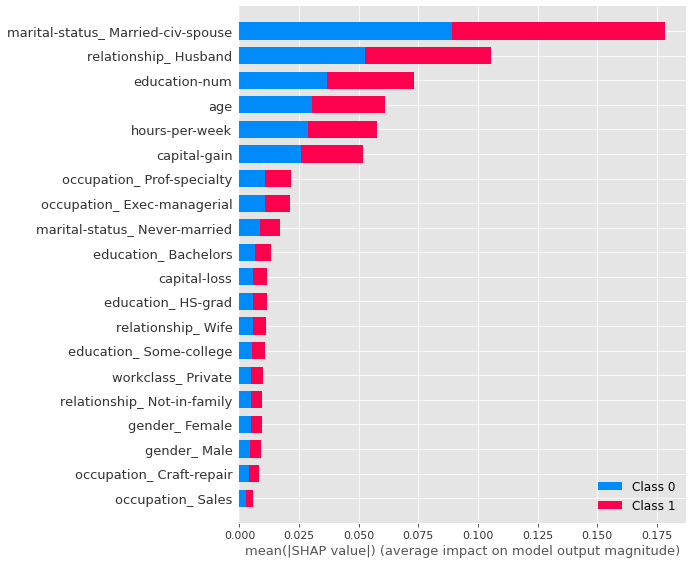

In [19]:
generate_feature_importance_plot(FeatureImportanceType.SHAP, model_2)

 * Model 3 (Decision Tree)

19-Nov-20 16:37:37 - Generating a feature importance plot using SHAP for Model 3 ...
19-Nov-20 16:37:37 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


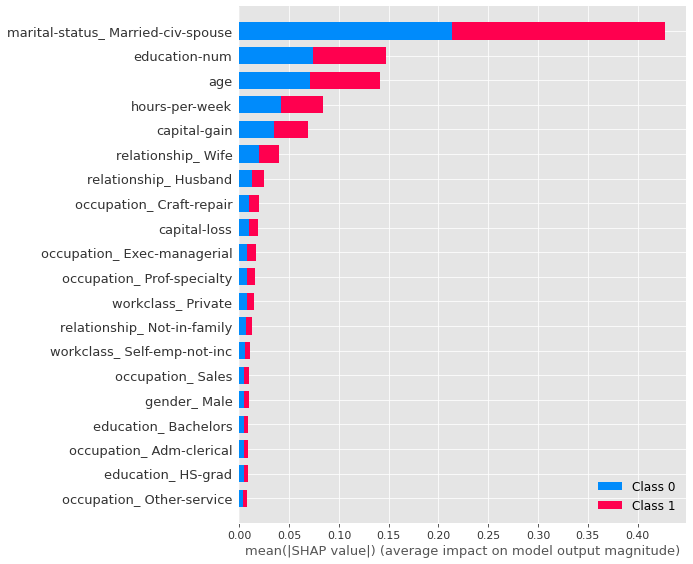

In [20]:
generate_feature_importance_plot(FeatureImportanceType.SHAP, model_3)

In [21]:
print(generate_feature_importance_explanation(FeatureImportanceType.SHAP, models, 4))

19-Nov-20 16:54:42 - Generating feature importance explanation for SHAP ...


Summary:
 The best feature for Model 1 is capital-gain with weight ~0.165.
 The 2nd most important feature for Model 1 is marital-status_ Married-civ-spouse with weight ~0.163.
 The 3rd most valuable feature for Model 1 is marital-status_ Never-married with weight ~0.121.
 The 4th most important feature for Model 1 is gender_ Female with weight ~0.078.
 
 The most influential feature for Model 2 is marital-status_ Married-civ-spouse with weight ~0.178, identical to 2nd for Model 1.
 The 2nd most important feature for Model 2 is relationship_ Husband with weight ~0.105.
 The 3rd most important feature for Model 2 is education-num with weight ~0.073.
 The 4th highest feature for Model 2 is age with weight ~0.061.
 
 The most valuable feature for Model 3 is marital-status_ Married-civ-spouse with weight ~0.427, matching 2nd for Model 1.
 The 2nd most influential feature for Model 3 is education-num with weight ~0.148, same as 3rd for Model 2.
 The 3rd most valuable feature for Model 3 is 

### Partial Dependence Plots
The partial dependence plot (short PDP or PD plot) shows the marginal effect one or two features have on the predicted outcome of a machine learning model. A partial dependence plot can show whether the relationship between the target and a feature is linear, monotonic or more complex. For example, when applied to a linear regression model, partial dependence plots always show a linear relationship.

#### PDPBox

[PDPBox](https://github.com/SauceCat/PDPbox) is the first module that we use for ploting partial dependence. We will generate two plots, one for only one feature - **age** and one for two features - **age** and **education-num**.
 * Model 1 (Logistic Regression)

19-Nov-20 16:54:42 - Generating a PDP plot using PDPBox for Model 1 ...
19-Nov-20 16:54:55 - Generating a PDP plot using PDPBox for Model 1 ...
19-Nov-20 16:54:56 - findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
19-Nov-20 16:54:56 - findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
19-Nov-20 16:54:57 - findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
19-Nov-20 16:54:57 - findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


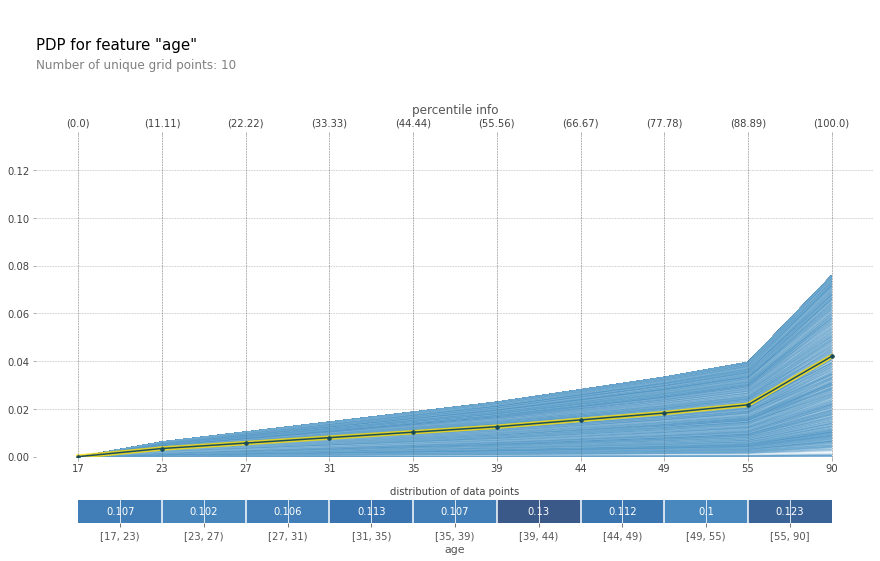

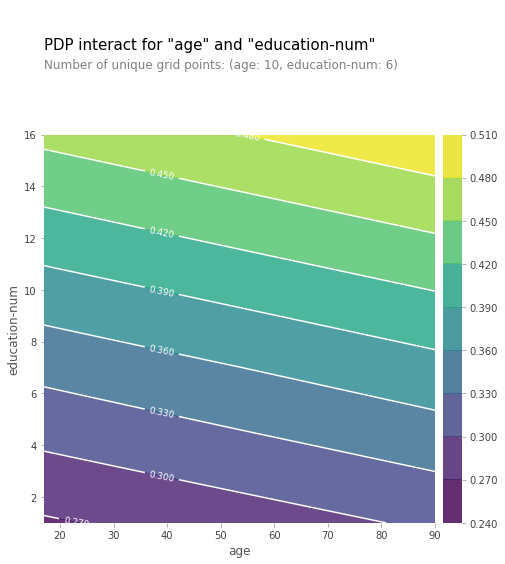

In [22]:
generate_pdp_plots(PDPType.PDPBox, model_1, "age", "None")
generate_pdp_plots(PDPType.PDPBox, model_1, "age", "education-num")

 * Model2 (Random Forest)

19-Nov-20 16:55:06 - Generating a PDP plot using PDPBox for Model 2 ...
19-Nov-20 16:55:20 - Generating a PDP plot using PDPBox for Model 2 ...


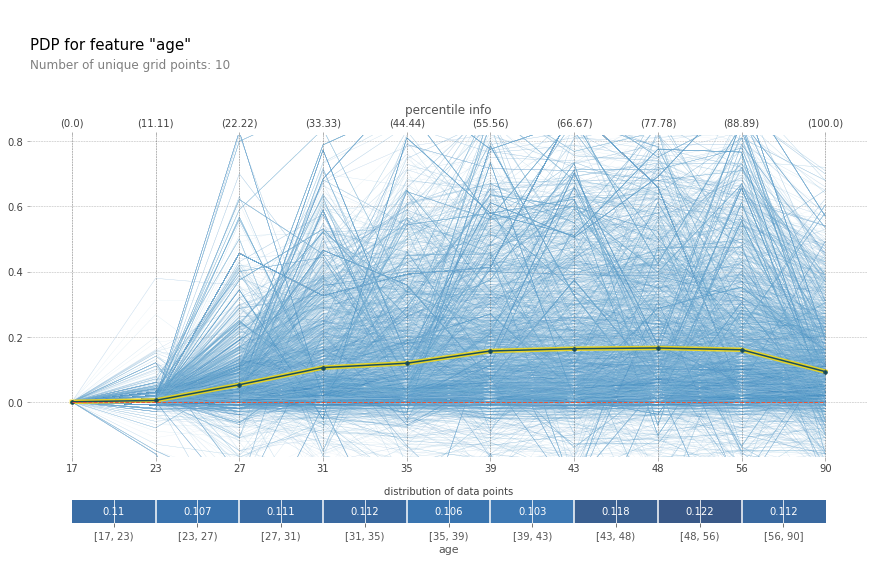

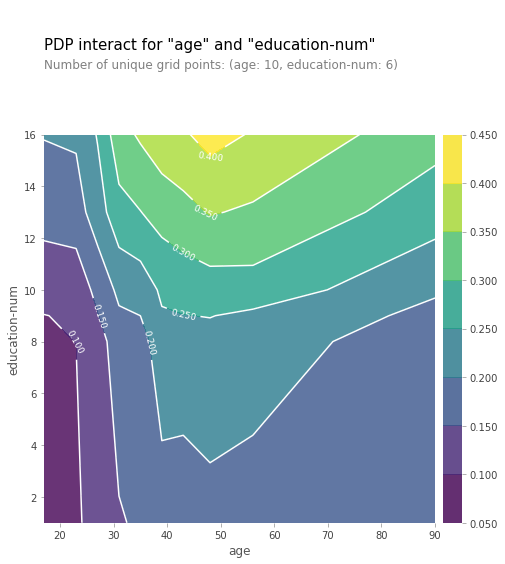

In [23]:
generate_pdp_plots(PDPType.PDPBox, model_2, "age", "None")
generate_pdp_plots(PDPType.PDPBox, model_2, "age", "education-num")

 * Model 3 (Decision Tree)

19-Nov-20 16:55:40 - Generating a PDP plot using PDPBox for Model 3 ...
19-Nov-20 16:55:53 - Generating a PDP plot using PDPBox for Model 3 ...


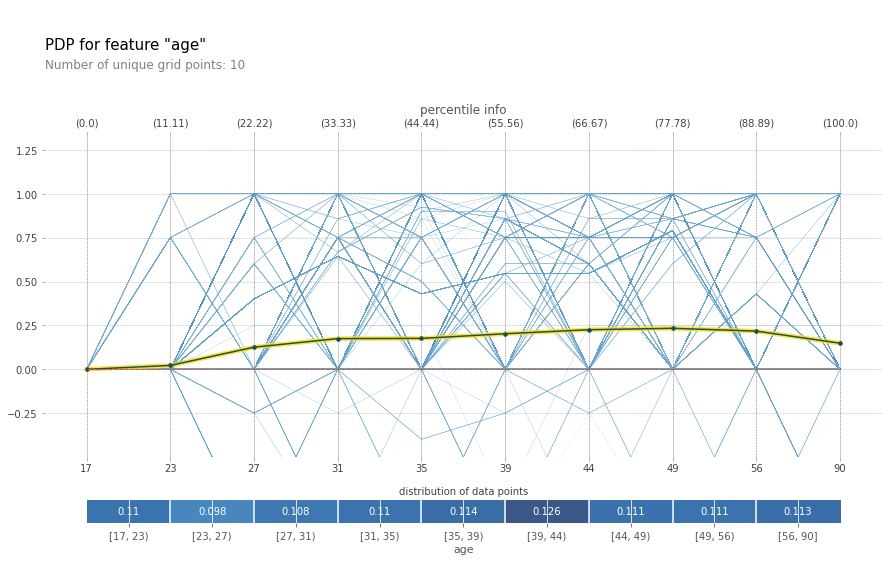

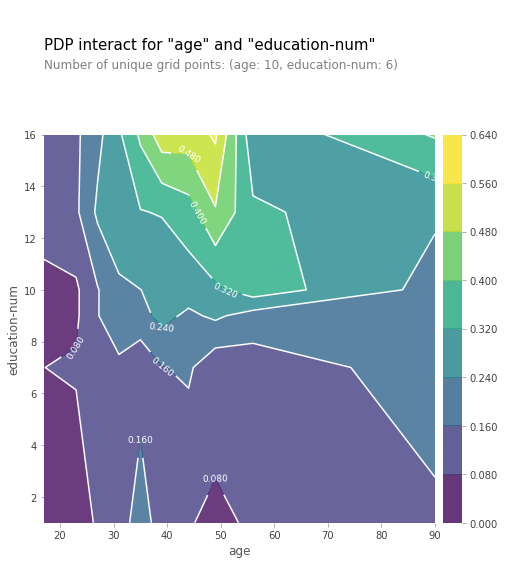

In [24]:
generate_pdp_plots(PDPType.PDPBox, model_3, "age", "None")
generate_pdp_plots(PDPType.PDPBox, model_3, "age", "education-num")

In the two examples below we will use *Skater* and *SHAP* for generating PDPs using features: **age** and **education-num**.
#### Skater
 * Model 1 (Logistic Regression)

19-Nov-20 16:56:04 - Generating a PDP plot using SKATER for Model 1 ...
2020-11-19 16:56:15,339 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[1152/1152] grid cells ████████████████████ Time elapsed: 414 seconds

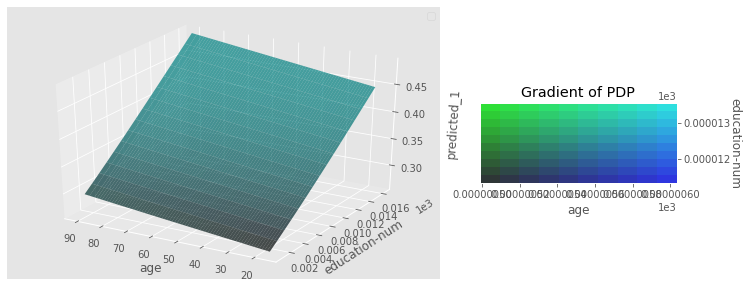

In [25]:
generate_pdp_plots(PDPType.SKATER, model_1, "age", "education-num")

 * Model2 (Random Forest)

19-Nov-20 17:03:11 - Generating a PDP plot using SKATER for Model 2 ...
2020-11-19 17:03:22,281 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[1136/1136] grid cells ████████████████████ Time elapsed: 520 seconds

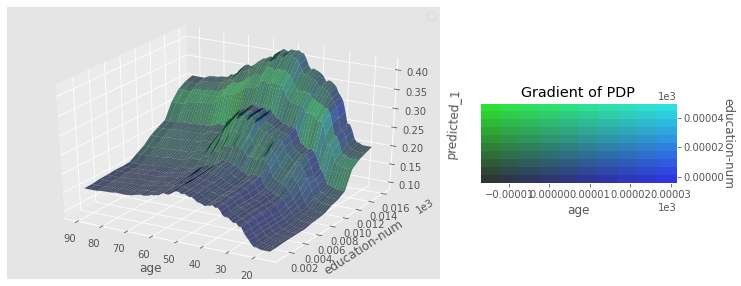

In [26]:
generate_pdp_plots(PDPType.SKATER, model_2, "age", "education-num")

 * Model 3 (Decision Tree)

19-Nov-20 17:12:03 - Generating a PDP plot using SKATER for Model 3 ...
2020-11-19 17:12:14,808 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[1136/1136] grid cells ████████████████████ Time elapsed: 342 seconds

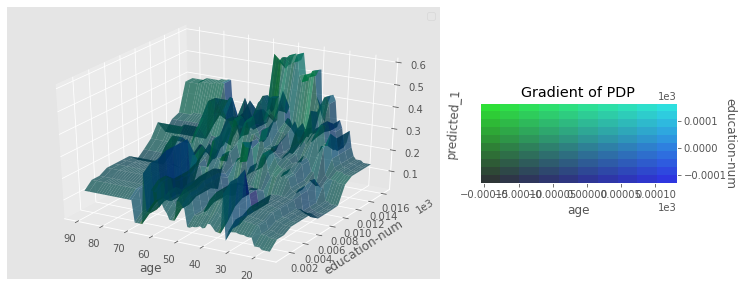

In [27]:
generate_pdp_plots(PDPType.SKATER, model_3, "age", "education-num")

#### SHAP
 * Model 1 (Logistic Regression)

19-Nov-20 17:17:58 - Generating a PDP plot using SHAP for Model 1 ...


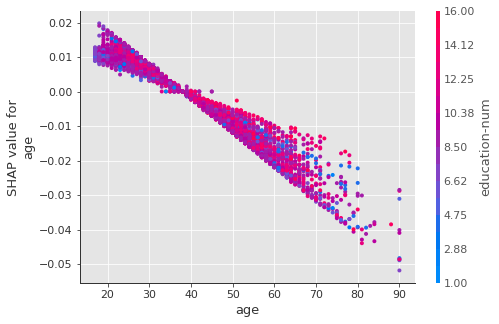

In [28]:
generate_pdp_plots(PDPType.SHAP, model_1, "age", "education-num")

 * Model2 (Random Forest)

19-Nov-20 17:17:59 - Generating a PDP plot using SHAP for Model 2 ...


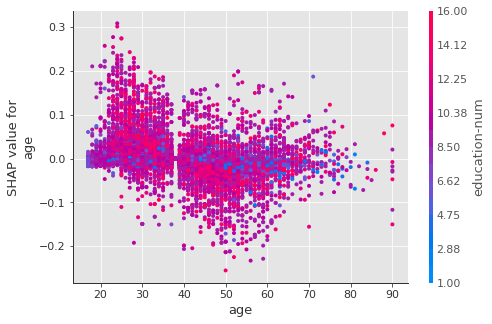

In [29]:
generate_pdp_plots(PDPType.SHAP, model_2, "age", "education-num")

 * Model 3 (Decision Tree)

19-Nov-20 17:18:00 - Generating a PDP plot using SHAP for Model 3 ...


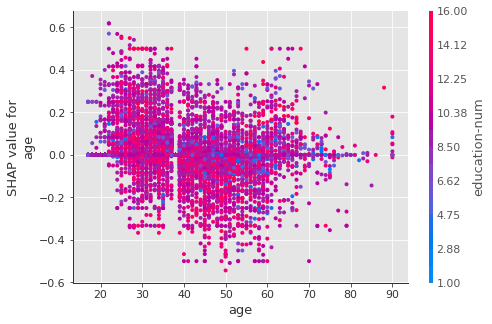

In [30]:
generate_pdp_plots(PDPType.SHAP, model_3, "age", "education-num")

## Local model interpretations
Local interpretation focuses on specifics of each individual and provides explanations that can lead to a better understanding of the feature contribution in smaller groups of individuals that are often overlooked by the global interpretation techniques. We will use two moduels for interpreting single instances - SHAP and LIME.

#### SHAP
SHAP leverages the idea of Shapley values for model feature influence scoring. The technical definition of a Shapley value is the “average marginal contribution of a feature value over all possible coalitions.” In other words, Shapley values consider all possible predictions for an instance using all possible combinations of inputs. Because of this exhaustive approach, SHAP can guarantee properties like consistency and local accuracy. LIME, on the other hand, does not offer such guarantees.

#### LIME
[LIME](https://github.com/marcotcr/lime) (Local Interpretable Model-agnostic Explanations) builds sparse linear models around each prediction to explain how the black box model works in that local vicinity. While treating the model as a black box, we perturb the instance we want to explain and learn a sparse linear model around it, as an explanation. LIME has the advantage over *SHAP*, that it is a lot faster.



In [48]:
examples = [] + get_test_examples(model_1, ExampleType.FALSELY_CLASSIFIED, 2)
examples = examples + get_test_examples(model_2, ExampleType.TRULY_CLASSIFIED, 2)
examples

[3871, 7341, 6375, 4637]

##### Example 1

In [49]:
print(get_example_information(model_1, examples[0]))
print(generate_single_instance_comparison(models, examples[0]))

Example 3871's data: 
age                             45
workclass                Local-gov
education                Bachelors
education-num                   13
marital-status            Divorced
occupation         Protective-serv
relationship         Not-in-family
ethnicity                    White
gender                        Male
capital-gain                     0
capital-loss                     0
hours-per-week                  40
Name: 12212, dtype: object
Actual result for example 3871:  >50K

Example 3871 was truly classified by Model 2, Model 3 and falsely classified by Model 1.
 For further clarification see the explanations below.



* Model 1 (Logistic Regression)

In [50]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_1, examples[0])
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_1, examples[0]))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, examples[0])
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, examples[0]))
display(explanation)

The prediction probability of Model 1's decision for this example is 0.58. LIME's explanation: 
The feature that mostly affects Model 1's positive (1) prediction probability is education= Bachelors with value of 0.09.
The feature with the second biggest affect on Model 1's positive (1) prediction probability is 10.00 < education-num <= 13.00 with value of 0.0527.
The feature that largely influences Model 1's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5765.
The feature with the second most substantial influence on Model 1's negative (0) prediction probability is capital-loss <= 0.00 with value of -0.2093.




The prediction probability of Model 1's decision for this example is 0.58. SHAP's explanation: 
The feature that primarily influences Model 1's positive (1) prediction probability is capital-gain with value of 0.0849.
The feature with the second most considerable influence on Model 1's positive (1) prediction probability is relationship_ Not-in-family with value of 0.0792.
The third most influential feature for the positive (1) prediction probability of Model 1 is marital-status_ Divorced with value of 0.0691
The feature that largely impacts Model 1's negative (0) prediction probability is workclass_ Private with value of -0.1021.
The feature with the second most substantial change on Model 1's negative (0) prediction probability is education_ Bachelors with value of -0.07.




 * Model2 (Random Forest)

In [51]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_2, examples[0])
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_2, examples[0]))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, examples[0])
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, examples[0]))
display(explanation)

The prediction probability of Model 2's decision for this example is 1.0. LIME's explanation: 
The feature that mostly affects Model 2's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.4648.
The feature with the second biggest impact on Model 2's negative (0) prediction probability is marital-status= Never-married with value of -0.1055.




The prediction probability of Model 2's decision for this example is 1.0. SHAP's explanation: 
The feature that primarily influences Model 2's positive (1) prediction probability is marital-status_ Never-married with value of 0.0171.
The feature with the second most considerable impact on Model 2's positive (1) prediction probability is relationship_ Own-child with value of 0.0104.
The third most impactful feature for the positive (1) prediction probability of Model 2 is ethnicity_ Black with value of 0.0069
The feature that mostly affects Model 2's negative (0) prediction probability is age with value of -0.0126.
The feature with the second largest influence on Model 2's negative (0) prediction probability is occupation_ Machine-op-inspct with value of -0.0091.




* Model 3 (Decision Tree)

In [52]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_3, examples[0])
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_3, examples[0]))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, examples[0])
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, examples[0]))
display(explanation)

The prediction probability of Model 3's decision for this example is 1.0. LIME's explanation: 
The feature that primarily impacts Model 3's positive (1) prediction probability is 10.00 < education-num <= 13.00 with value of 0.052.
The feature that primarily impacts Model 3's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.4737.
The feature with the second most considerable influence on Model 3's negative (0) prediction probability is marital-status= Never-married with value of -0.1104.




The prediction probability of Model 3's decision for this example is 1.0. SHAP's explanation: 




##### Example 2

In [53]:
print(get_example_information(model_1, examples[1]))
print(generate_single_instance_comparison(models, examples[1]))

Example 7341's data: 
age                                42
workclass                   Local-gov
education                   Bachelors
education-num                      13
marital-status     Married-civ-spouse
occupation            Protective-serv
relationship                  Husband
ethnicity                       White
gender                           Male
capital-gain                        0
capital-loss                        0
hours-per-week                     42
Name: 32150, dtype: object
Actual result for example 7341:  <=50K

Example 7341 was truly classified by Model 2, Model 3 and falsely classified by Model 1.
 For further clarification see the explanations below.



* Model 1 (Logistic Regression)

In [54]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_1, examples[1])
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_1, examples[1]))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, examples[1])
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, examples[1]))
display(explanation)

The prediction probability of Model 1's decision for this example is 0.81. LIME's explanation: 
The feature that mainly impacts Model 1's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.2796.
The feature with the second most considerable influence on Model 1's positive (1) prediction probability is relationship= Husband with value of 0.1112.
The third most influential feature for the positive (1) prediction probability of Model 1 is education= Bachelors with value of 0.0939
The feature that mainly changes Model 1's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5435.
The feature with the second most considerable influence on Model 1's negative (0) prediction probability is capital-loss <= 0.00 with value of -0.1954.




The prediction probability of Model 1's decision for this example is 0.81. SHAP's explanation: 
The feature that mostly affects Model 1's positive (1) prediction probability is marital-status_ Married-civ-spouse with value of 0.1778.
The feature with the second most considerable impact on Model 1's positive (1) prediction probability is workclass_ Private with value of 0.0916.
The third most important feature for the positive (1) prediction probability of Model 1 is education_ Bachelors with value of 0.0624
The feature that primarily influences Model 1's negative (0) prediction probability is capital-gain with value of -0.0733.
The feature with the second biggest impact on Model 1's negative (0) prediction probability is workclass_ Local-gov with value of -0.0468.




 * Model2 (Random Forest)

In [55]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_2, examples[1])
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_2, examples[1]))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, examples[1])
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, examples[1]))
display(explanation)

The prediction probability of Model 2's decision for this example is 0.74. LIME's explanation: 
The feature that primarily influences Model 2's positive (1) prediction probability is capital-gain > 0.00 with value of 0.4632.
The feature with the second most considerable affect on Model 2's positive (1) prediction probability is hours-per-week > 45.00 with value of 0.0615.
The third most influential feature for the positive (1) prediction probability of Model 2 is occupation= Prof-specialty with value of 0.0607
The feature that primarily impacts Model 2's negative (0) prediction probability is education-num <= 9.00 with value of -0.0659.




The prediction probability of Model 2's decision for this example is 0.74. SHAP's explanation: 
The feature that primarily affects Model 2's positive (1) prediction probability is capital-gain with value of 0.6308.
The feature with the second most substantial influence on Model 2's positive (1) prediction probability is occupation_ Prof-specialty with value of 0.0672.
The third most influential feature for the positive (1) prediction probability of Model 2 is age with value of 0.0501
The feature that mostly impacts Model 2's negative (0) prediction probability is education-num with value of -0.0247.
The feature with the second biggest impact on Model 2's negative (0) prediction probability is education_ 10th with value of -0.0238.




* Model 3 (Decision Tree)

In [56]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_3, examples[1])
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_3, examples[1]))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, examples[1])
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, examples[1]))
display(explanation)

The prediction probability of Model 3's decision for this example is 1.0. LIME's explanation: 
The feature that primarily impacts Model 3's positive (1) prediction probability is hours-per-week > 45.00 with value of 0.0604.
The feature that primarily affects Model 3's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5391.
The feature with the second largest impact on Model 3's negative (0) prediction probability is capital-loss <= 0.00 with value of -0.1225.




The prediction probability of Model 3's decision for this example is 1.0. SHAP's explanation: 
The feature that mainly changes Model 3's positive (1) prediction probability is marital-status_ Never-married with value of 0.0571.
The feature with the second largest influence on Model 3's positive (1) prediction probability is age with value of 0.0571.
The third most impactful feature for the positive (1) prediction probability of Model 3 is relationship_ Own-child with value of 0.0071
The feature that largely influences Model 3's negative (0) prediction probability is hours-per-week with value of -0.0429.
The feature with the second biggest impact on Model 3's negative (0) prediction probability is education-num with value of -0.0429.




##### Example 3

In [57]:
print(get_example_information(model_1, examples[2]))
print(generate_single_instance_comparison(models, examples[2]))

Example 6375's data: 
age                               21
workclass                    Private
education                    HS-grad
education-num                      9
marital-status         Never-married
occupation         Handlers-cleaners
relationship           Not-in-family
ethnicity                      White
gender                          Male
capital-gain                       0
capital-loss                       0
hours-per-week                    40
Name: 25776, dtype: object
Actual result for example 6375:  <=50K

Example 6375 was truly classified by Model 1, Model 2 and falsely classified by Model 3.
 For further clarification see the explanations below.



* Model 1 (Logistic Regression)

In [58]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_1, examples[2])
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_1, examples[2]))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, examples[2])
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, examples[2]))
display(explanation)

The prediction probability of Model 1's decision for this example is 0.96. LIME's explanation: 
The feature that primarily influences Model 1's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5758.
The feature with the second largest change on Model 1's negative (0) prediction probability is marital-status= Never-married with value of -0.2632.




The prediction probability of Model 1's decision for this example is 0.96. SHAP's explanation: 
The feature that mainly impacts Model 1's positive (1) prediction probability is marital-status_ Never-married with value of 0.1736.
The feature with the second largest influence on Model 1's positive (1) prediction probability is education_ HS-grad with value of 0.0737.
The third most important feature for the positive (1) prediction probability of Model 1 is occupation_ Handlers-cleaners with value of 0.0512




 * Model2 (Random Forest)

In [59]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_2, examples[2])
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_2, examples[2]))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, examples[2])
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, examples[2]))
display(explanation)

The prediction probability of Model 2's decision for this example is 1.0. LIME's explanation: 
The feature that mostly influences Model 2's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.456.
The feature with the second most substantial affect on Model 2's negative (0) prediction probability is marital-status= Never-married with value of -0.1154.




The prediction probability of Model 2's decision for this example is 1.0. SHAP's explanation: 
The feature that mostly affects Model 2's positive (1) prediction probability is marital-status_ Never-married with value of 0.0426.
The feature with the second biggest impact on Model 2's positive (1) prediction probability is age with value of 0.0308.
The third most influential feature for the positive (1) prediction probability of Model 2 is gender_ Male with value of 0.0147
The feature that mainly affects Model 2's negative (0) prediction probability is occupation_ Prof-specialty with value of -0.0484.
The feature with the second most considerable affect on Model 2's negative (0) prediction probability is education-num with value of -0.0391.




* Model 3 (Decision Tree)

In [60]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_3, examples[2])
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_3, examples[2]))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, examples[2])
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, examples[2]))
display(explanation)

The prediction probability of Model 3's decision for this example is 1.0. LIME's explanation: 
The feature that mainly influences Model 3's positive (1) prediction probability is occupation= Exec-managerial with value of 0.061.
The feature that primarily changes Model 3's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.4778.
The feature with the second largest affect on Model 3's negative (0) prediction probability is marital-status= Never-married with value of -0.117.




The prediction probability of Model 3's decision for this example is 1.0. SHAP's explanation: 
The feature that mostly affects Model 3's positive (1) prediction probability is age with value of 0.3422.
The feature with the second most considerable change on Model 3's positive (1) prediction probability is occupation_ Exec-managerial with value of 0.3366.
The third most effective feature for the positive (1) prediction probability of Model 3 is education-num with value of 0.3237
The feature that mainly changes Model 3's negative (0) prediction probability is capital-loss with value of -0.0071.
The feature with the second largest change on Model 3's negative (0) prediction probability is gender_ Male with value of -0.0062.




##### Example 4

In [61]:
print(get_example_information(model_1, examples[1]))
print(generate_single_instance_comparison(models, examples[1]))

Example 7341's data: 
age                                42
workclass                   Local-gov
education                   Bachelors
education-num                      13
marital-status     Married-civ-spouse
occupation            Protective-serv
relationship                  Husband
ethnicity                       White
gender                           Male
capital-gain                        0
capital-loss                        0
hours-per-week                     42
Name: 32150, dtype: object
Actual result for example 7341:  <=50K

Example 7341 was truly classified by Model 2, Model 3 and falsely classified by Model 1.
 For further clarification see the explanations below.



* Model 1 (Logistic Regression)

In [62]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_1, examples[3])
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_1, examples[3]))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, examples[3])
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, examples[3]))
display(explanation)

The prediction probability of Model 1's decision for this example is 0.93. LIME's explanation: 
The feature that primarily influences Model 1's positive (1) prediction probability is occupation= Exec-managerial with value of 0.1466.
The feature that primarily changes Model 1's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5828.
The feature with the second biggest change on Model 1's negative (0) prediction probability is marital-status= Never-married with value of -0.2625.




The prediction probability of Model 1's decision for this example is 0.93. SHAP's explanation: 
The feature that primarily affects Model 1's positive (1) prediction probability is marital-status_ Never-married with value of 0.1978.
The feature with the second biggest influence on Model 1's positive (1) prediction probability is relationship_ Own-child with value of 0.1417.
The third most important feature for the positive (1) prediction probability of Model 1 is education_ HS-grad with value of 0.0821
The feature that primarily affects Model 1's negative (0) prediction probability is occupation_ Exec-managerial with value of -0.1087.




 * Model2 (Random Forest)

In [63]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_2, examples[3])
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_2, examples[3]))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, examples[3])
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, examples[3]))
display(explanation)

The prediction probability of Model 2's decision for this example is 0.97. LIME's explanation: 
The feature that primarily changes Model 2's positive (1) prediction probability is age > 47.00 with value of 0.0515.
The feature that mainly impacts Model 2's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.4598.
The feature with the second most substantial impact on Model 2's negative (0) prediction probability is occupation= Other-service with value of -0.0696.




The prediction probability of Model 2's decision for this example is 0.97. SHAP's explanation: 
The feature that mainly impacts Model 2's positive (1) prediction probability is education-num with value of 0.0195.
The feature with the second most substantial change on Model 2's positive (1) prediction probability is occupation_ Other-service with value of 0.007.
The feature that mainly impacts Model 2's negative (0) prediction probability is age with value of -0.021.
The feature with the second most substantial change on Model 2's negative (0) prediction probability is marital-status_ Divorced with value of -0.0143.




* Model 3 (Decision Tree)

In [64]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_3, examples[3])
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_3, examples[3]))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, examples[3])
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, examples[3]))
display(explanation)

The prediction probability of Model 3's decision for this example is 0.6. LIME's explanation: 
The feature that mostly changes Model 3's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.1404.
The feature with the second most considerable impact on Model 3's positive (1) prediction probability is 37.00 < age <= 47.00 with value of 0.027.
The feature that largely impacts Model 3's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5096.
The feature with the second biggest affect on Model 3's negative (0) prediction probability is hours-per-week <= 40.00 with value of -0.083.




The prediction probability of Model 3's decision for this example is 0.6. SHAP's explanation: 
The feature that mostly changes Model 3's positive (1) prediction probability is marital-status_ Married-civ-spouse with value of 0.6651.
The feature with the second largest change on Model 3's positive (1) prediction probability is relationship_ Husband with value of 0.025.
The third most effective feature for the positive (1) prediction probability of Model 3 is education-num with value of 0.0146
The feature that mostly affects Model 3's negative (0) prediction probability is occupation_ Craft-repair with value of -0.0641.
The feature with the second biggest influence on Model 3's negative (0) prediction probability is age with value of -0.021.


